<a href="https://colab.research.google.com/github/COVID-19-Severity/DataSet/blob/main/COVID19_Severity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<hr>

# :: COVID-19 Severity ::


<hr>

# MACHINE LEARNING (ML)
Development of a Machine Learning model for the prognosis of COVID-19 in terms of SEVERITY using laboratory biomarkers.
The data are from examinations of patients treated at the Hospital de Clínicas of the Federal University of Paraná
# LEGEND:
### Sex:
##### 1=Female
##### 2=Male
### COVID:
##### * Total: 35,109 Positive Samples
##### * Non-Severe (Mild to Moderate): 7,719 samples
##### * Severe: 27,390 samples
### Classification Severity:
##### * Severe (Serious - Inpatients)
##### * Non-Severe (Mild to Moderate - Outpatients)
### Period of the Samples:
##### * March 2020 to September 2022

# OBJECTIVE:
Develop a Machine Learning model to predict the DataSetSeverity of COVID-19 and identify biomarkers associated with this DataSetSeverity in order to optimize priority in hospital care.

# SCRIPT:
The script in the Python programming language was executed in the Google Colab environment.

In [ ]:
# PHASES:
# 1: Import the DataSet
# 2: Import the Pandas library for handling the DataSet
# 3: Remove unnecessary columns (features) from DataSet
# 4: Exploratory Analysis
# 5: Install the Pycaret library to aid Auto-Machine Learn
# 6: Import the Pycaret library
# 7: Perform data pre-processing
# 8: Build and compare models
# 9: Train the best model based on predictive performance metrics
#10: Extract the metrics results from the model
#11: Write conclusions about the best identified model
#12: Save the model to make predictions in real analyzes (Deploy)

In [ ]:
# Phase 1: Import the DataSet SEVERITY.csv

from google.colab import files
uploaded = files.upload()

Saving SEVERITY.csv to SEVERITY.csv


In [ ]:
# Phase 2: Import the Pandas library for handling the DataSet
import pandas as pd
DataSet = pd.read_csv("COVID19 DataSetSeverity.csv")
display (DataSet)

,ID,COVID,Age,Sex,Erythrocytes,Haemoglobin,Leukocytes,Mature Neutrophils,Immature Neutrophils,Neutrophils,...,pCO2,pO2,sO2,pH,HCO3 (standard),HCO3 (actual),BE(ECF),BE(B),CTCO2,Procalcitonin
0,1,Non-Severe,56,2,2.66,NaN,8.67,NaN,1.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,Non-Severe,76,1,4.49,NaN,11.84,NaN,6.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,Non-Severe,56,2,2.98,NaN,8.05,NaN,4.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,Non-Severe,68,2,4.37,NaN,9.76,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,Non-Severe,61,1,4.70,NaN,7.92,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35104,35105,Severe,47,2,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35105,35106,Severe,61,2,3.30,NaN,6.55,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35106,35107,Severe,47,2,4.06,NaN,8.42,NaN,5.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35107,35108,Severe,55,2,4.58,NaN,12.15,NaN,8.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Nova seção

In [ ]:
# Phase 3: Remove unnecessary columns (features) from DataSet
DataSetSeverity = DataSet.drop("ID", axis = 1)
display (DataSetSeverity)

,COVID,Age,Sex,Erythrocytes,Haemoglobin,Leukocytes,Mature Neutrophils,Immature Neutrophils,Neutrophils,Basophils,...,pCO2,pO2,sO2,pH,HCO3 (standard),HCO3 (actual),BE(ECF),BE(B),CTCO2,Procalcitonin
0,Non-Severe,56,2,2.66,NaN,8.67,NaN,1.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Non-Severe,76,1,4.49,NaN,11.84,NaN,6.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Non-Severe,56,2,2.98,NaN,8.05,NaN,4.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Non-Severe,68,2,4.37,NaN,9.76,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Non-Severe,61,1,4.70,NaN,7.92,NaN,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35104,Severe,47,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35105,Severe,61,2,3.30,NaN,6.55,NaN,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35106,Severe,47,2,4.06,NaN,8.42,NaN,5.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35107,Severe,55,2,4.58,NaN,12.15,NaN,8.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Phase 4: Exploratory Analysis
## 4.1. DataSet Informations
DataSetSeverity.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35109 entries, 0 to 35108
Data columns (total 51 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   COVID                                              35109 non-null  object 
 1   Age                                                35109 non-null  int64  
 2   Sex                                                35109 non-null  int64  
 3   Erythrocytes                                       27977 non-null  float64
 4   Haemoglobin                                        236 non-null    float64
 5   Leukocytes                                         28100 non-null  float64
 6   Mature Neutrophils                                 131 non-null    float64
 7   Immature Neutrophils                               23962 non-null  float64
 8   Neutrophils                                        132 non-null    float64
 9   Basoph

In [ ]:
## 4.2. Install and Import library for Descriptive Statistics
!pip install researchpy
import researchpy as rp
### 1: COVID Feature
rp.summary_cat(DataSetSeverity['COVID'])

,Variable,Outcome,Count,Percent
0,COVID,Severe,27390,78.01
1,,Non-Severe,7719,21.99


In [ ]:
### 2: Sex Feature
rp.summary_cat(DataSetSeverity['Sex'])

,Variable,Outcome,Count,Percent
0,Sex,2,19504,55.55
1,,1,15605,44.45


In [ ]:
### 3: Biomarkers Features
DescriptiveStat = DataSetSeverity
DataStatistics = DescriptiveStat.drop("COVID", axis = 1)
DataStatistics = DataStatistics.drop("Sex", axis = 1)
for statistical in DataStatistics.columns:
  display(rp.summary_cont(DataStatistics[statistical]))

,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Age,35109.0,51.6917,20.7704,0.1109,51.4745,51.909


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Erythrocytes,27977.0,3.7228,0.9563,0.0057,3.7116,3.734


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Haemoglobin,236.0,9.2301,2.5486,0.1659,8.9032,9.5569


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Leukocytes,28100.0,18.7901,311.2146,1.8566,15.1511,22.429


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Mature Neutrophils,131.0,51.7206,30.1088,2.6306,46.5162,56.925


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Immature Neutrophils,23962.0,8.2177,9.0723,0.0586,8.1028,8.3326


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Neutrophils,132.0,52.0864,30.2866,2.6361,46.8715,57.3012


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Basophils,131.0,0.3107,0.5819,0.0508,0.2101,0.4113


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Eosinophils,131.0,2.9733,8.0494,0.7033,1.5819,4.3646


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Lymphocytes,28098.0,18.3276,14.7855,0.0882,18.1547,18.5004


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Atypical Lymphocytes,23837.0,0.0842,0.3951,0.0026,0.0792,0.0892


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Monocytes,28098.0,6.8916,4.9824,0.0297,6.8334,6.9499


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Platelets,28219.0,251615.441,156999.4019,934.603,249783.5741,253447.3079


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Prothrombin Time,8777.0,15.4055,8.2819,0.0884,15.2322,15.5788


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Prothrombin Time – Relation*,8757.0,1.408,1.5861,0.0169,1.3748,1.4412


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Prothrombin Time - International Normalized Ratio,8785.0,1.4466,1.8551,0.0198,1.4078,1.4854


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Partial Thromboplastin Time,2401.0,32.9669,13.0154,0.2656,32.4461,33.4878


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Partial Thromboplastin Time – Relation*,2391.0,1.2919,1.547,0.0316,1.2298,1.3539


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,D-Dimer,5102.0,5.7938,66.6974,0.9338,3.9632,7.6244


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Glucose,6958.0,125.1138,72.5043,0.8692,123.4099,126.8177


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,HbA1c,1354.0,6.8219,2.075,0.0564,6.7113,6.9326


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Total Cholesterol,1738.0,169.4873,53.7783,1.29,166.9573,172.0174


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,HDL-C,1424.0,39.9185,14.4876,0.3839,39.1654,40.6716


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,LDL-C,1378.0,101.1627,39.9522,1.0763,99.0514,103.274


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Triglycerides,1825.0,159.7912,121.2147,2.8374,154.2263,165.3562


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Creatinine,26990.0,1.3944,1.469,0.0089,1.3768,1.4119


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Urea,23970.0,65.2884,53.4779,0.3454,64.6113,65.9654


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Potassium,24510.0,4.4125,0.7624,0.0049,4.403,4.4221


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Sodium,24427.0,139.3832,4.9508,0.0317,139.3211,139.4453


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Alanine transaminase,11570.0,62.3107,219.867,2.0441,58.304,66.3174


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Aspartate transaminase,11538.0,65.2683,392.5113,3.6542,58.1056,72.4311


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Albumin,7561.0,3.2091,0.774,0.0089,3.1917,3.2266


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Total Protein,587.0,5.7272,1.4442,0.0596,5.6101,5.8442


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Globulin,587.0,2.3336,0.8752,0.0361,2.2626,2.4045


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Ferritin,6185.0,5236.4282,244233.9427,3105.5331,-851.4965,11324.3529


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,C-reactive protein,15689.0,7.5842,7.5281,0.0601,7.4664,7.702


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Amylase,896.0,123.5301,855.65,28.5853,67.4282,179.6321


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Lipase,907.0,189.5899,2348.8678,77.9929,36.5221,342.6576


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Troponin,3328.0,1789.749,26496.6591,459.3032,889.2037,2690.2943


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,pCO2,272.0,46.0662,18.3158,1.1106,43.8798,48.2526


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,pO2,269.0,79.7353,33.3306,2.0322,75.7342,83.7364


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,sO2,267.0,89.7116,14.2638,0.8729,87.9929,91.4303


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,pH,313.0,5962.286,2877.754,162.6603,5642.2362,6282.3358


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,HCO3 (standard),246.0,22.263,4.933,0.3145,21.6435,22.8825


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,HCO3 (actual),272.0,23.3088,5.5231,0.3349,22.6495,23.9681


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,BE(ECF),268.0,-2.3567,5.8116,0.355,-3.0557,-1.6578


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,BE(B),271.0,-2.3225,5.345,0.3247,-2.9617,-1.6833


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,CTCO2,269.0,24.7368,5.871,0.358,24.032,25.4416


,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Procalcitonin,1922.0,3.9072,31.0525,0.7083,2.5181,5.2963


In [ ]:
## 4.3. Analyzing the variation in biomarker levels between COVID-19 DataSetSeverity samples (SEVERE AND MILD TO MODERATE)

### 1: Import Plotly library to graphics
import plotly.express as px

### 2: Create Graphics
#      BOXPLOT
for biomarker in DataSetSeverity.columns:
    if biomarker != 'COVID' and biomarker != 'Sex':
      graphic = px.box(DataSetSeverity, x = DataSetSeverity.columns[0], y=biomarker, color="COVID")
      graphic.show()

In [ ]:
## Insights:
## In general, the levels of all biomarkers varied between SEVERE and MILD TO MODERATE samples for COVID-19.
## In general, SEVERE samples for COVID-19 had altered laboratory measurements compared to MILD TO MODERATE samples for COVID-19.
## SEVERE samples for COVID-19 demonstrate changes in laboratory measurements.
## All variables are important for analyzing the two groups of samples.
## The differences between the groups show that an in-depth study of supervised Machine Learning is justifiable.

In [ ]:
# Phase 5: Install the Pycaret library to aid Auto-Machine Learn
!pip install pycaret

In [ ]:
#Phase 6: Import the Pycaret library
from pycaret import classification

In [ ]:
# Phase 7: Perform data pre-processing
parameters = classification.setup(data = DataSetSeverity, target = "COVID", session_id=8801, fold_shuffle=False)

,Description,Value
0,Session id,8801
1,Target,COVID
2,Target type,Binary
3,Target mapping,"Non-Severe: 0, Severe: 1"
4,Original data shape,"(35109, 51)"
5,Transformed data shape,"(35109, 51)"
6,Transformed train set shape,"(24576, 51)"
7,Transformed test set shape,"(10533, 51)"
8,Numeric features,50
9,Rows with missing values,100.0%


In [ ]:
# Phase 8: Build and compare models
models = classification.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.8808,0.9177,0.8808,0.8757,0.8757,0.6250,0.6314,6.9560
xgboost,Extreme Gradient Boosting,0.8796,0.9153,0.8796,0.8747,0.8751,0.6247,0.6297,0.7510
rf,Random Forest Classifier,0.8786,0.9060,0.8786,0.8732,0.8725,0.6136,0.6220,5.2900
et,Extra Trees Classifier,0.8779,0.9047,0.8779,0.8726,0.8714,0.6098,0.6191,4.7040
gbc,Gradient Boosting Classifier,0.8636,0.8939,0.8636,0.8572,0.8525,0.5460,0.5645,5.7600
ada,Ada Boost Classifier,0.8481,0.8744,0.8481,0.8383,0.8375,0.5024,0.5153,1.3780
dt,Decision Tree Classifier,0.8144,0.7358,0.8144,0.8168,0.8155,0.4656,0.4658,0.5530
lda,Linear Discriminant Analysis,0.8087,0.7924,0.8087,0.7868,0.7794,0.3057,0.3401,0.2300
lr,Logistic Regression,0.8031,0.7783,0.8031,0.7785,0.7668,0.2619,0.3045,4.4330
ridge,Ridge Classifier,0.8029,0.7927,0.8029,0.7818,0.7587,0.2326,0.2909,0.1790


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [ ]:
# Phase 9: Train the best model based on predictive performance metrics
# First: The Light Gradient Boosting Machine (lightgbm) model achieved the best performance. We will create the Light Gradient Boosting Machine model
model_lightgbm = classification.create_model("lightgbm")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8763,0.9131,0.8763,0.8708,0.8692,0.6016,0.6123
1,0.8869,0.9166,0.8869,0.8825,0.8825,0.6461,0.6516
2,0.8853,0.9168,0.8853,0.8806,0.8803,0.6384,0.6451
3,0.8857,0.9281,0.8857,0.8812,0.8814,0.6436,0.6487
4,0.8747,0.9131,0.8747,0.8691,0.8695,0.6068,0.6127
5,0.8747,0.9128,0.8747,0.8690,0.8692,0.6057,0.6120
6,0.8889,0.9237,0.8889,0.8846,0.8846,0.6527,0.6581
7,0.8873,0.9295,0.8873,0.8833,0.8841,0.6540,0.6569
8,0.8738,0.9100,0.8738,0.8680,0.8681,0.6014,0.6082


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Second: The Extreme Gradient Boosting (xgboost) model second the best performance.
model_xgboost = classification.create_model("xgboost")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8788,0.9058,0.8788,0.8735,0.8736,0.6185,0.6247
1,0.8792,0.9149,0.8792,0.8745,0.8755,0.6275,0.6308
2,0.8820,0.9125,0.8820,0.8772,0.8776,0.6319,0.6368
3,0.8792,0.9242,0.8792,0.8741,0.8745,0.6228,0.6280
4,0.8771,0.9119,0.8771,0.8720,0.8727,0.6178,0.6224
5,0.8804,0.9164,0.8804,0.8753,0.8751,0.6231,0.6299
6,0.8844,0.9198,0.8844,0.8800,0.8807,0.6425,0.6463
7,0.8869,0.9290,0.8869,0.8833,0.8843,0.6559,0.6578
8,0.8775,0.9089,0.8775,0.8721,0.8723,0.6149,0.6209


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Third: The Random Forest Classifier (rf) model third the best performance.
model_rf = classification.create_model("rf")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8714,0.9073,0.8714,0.8652,0.8641,0.5865,0.5966
1,0.8824,0.9112,0.8824,0.8776,0.8779,0.6324,0.6377
2,0.8804,0.9024,0.8804,0.8752,0.8749,0.6220,0.6290
3,0.8865,0.9146,0.8865,0.8822,0.8807,0.6384,0.6475
4,0.8808,0.8955,0.8808,0.8757,0.8752,0.6230,0.6305
5,0.8686,0.9034,0.8686,0.8621,0.8602,0.5734,0.5858
6,0.8856,0.9138,0.8856,0.8811,0.8808,0.6405,0.6468
7,0.8873,0.9178,0.8873,0.8829,0.8832,0.6491,0.6539
8,0.8718,0.8931,0.8718,0.8657,0.8642,0.5863,0.5972


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Fourth: The Extra Trees Classifier (et) model fourth the best performance.
model_et = classification.create_model("et")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8694,0.9029,0.8694,0.8629,0.8615,0.5778,0.5889
1,0.8779,0.9055,0.8779,0.8726,0.8729,0.6170,0.6227
2,0.8804,0.9043,0.8804,0.8752,0.8745,0.6198,0.6279
3,0.8873,0.9129,0.8873,0.8832,0.8812,0.6395,0.6496
4,0.8767,0.8945,0.8767,0.8712,0.8707,0.6090,0.6168
5,0.8674,0.9035,0.8674,0.8608,0.8584,0.5672,0.5808
6,0.8828,0.9101,0.8828,0.8779,0.8776,0.6302,0.6370
7,0.8864,0.9134,0.8864,0.8819,0.8815,0.6425,0.6491
8,0.8763,0.8977,0.8763,0.8708,0.8689,0.6004,0.6118


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Fifth: The Gradient Boosting Classifier (gbc) model fifth the best performance.
model_gbc = classification.create_model("gbc")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8641,0.8834,0.8641,0.8588,0.8514,0.5400,0.5636
1,0.8653,0.8987,0.8653,0.8591,0.8545,0.5521,0.5703
2,0.8621,0.8939,0.8621,0.8554,0.8505,0.5392,0.5583
3,0.8694,0.9032,0.8694,0.8635,0.8599,0.5709,0.5865
4,0.8621,0.8902,0.8621,0.8556,0.8503,0.5386,0.5586
5,0.8592,0.8896,0.8592,0.8519,0.8476,0.5308,0.5494
6,0.8649,0.9025,0.8649,0.8582,0.8547,0.5538,0.5699
7,0.8694,0.9058,0.8694,0.8632,0.8604,0.5727,0.5867
8,0.8641,0.8817,0.8641,0.8578,0.8528,0.5463,0.5654


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Phase 10: Extract the metrics results from the 5 top models
# First: lightgbm model metrics
classification.evaluate_model(model_lightgbm)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
# Second: xgboost model metrics
classification.evaluate_model(model_xgboost)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
# Third: rf model metrics
classification.evaluate_model(model_rf)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
# Fourth: et model metrics
classification.evaluate_model(model_et)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
# Fifth: gbc model metrics
classification.evaluate_model(model_gbc)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

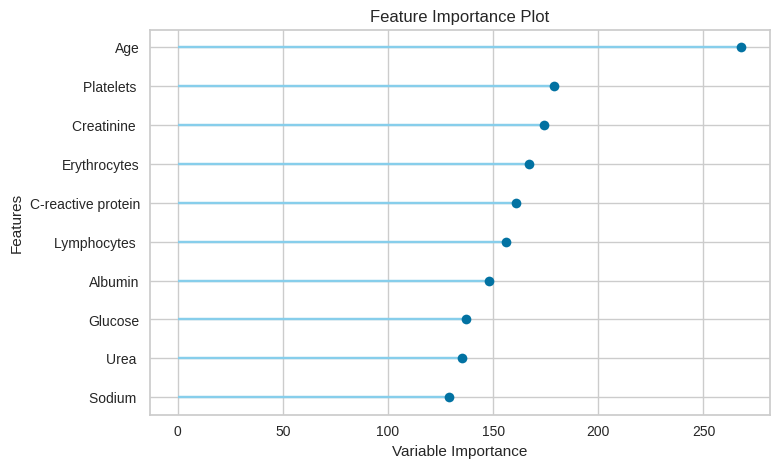

In [ ]:
# Plotting only the 10 most important biomarkers for lightgbm model
classification.plot_model(model_lightgbm, plot ="feature")

In [ ]:
# Phase 11: Write conclusions about the best identified model
# Several Machine Learning models were built to predict the diagnosis of COVID-19 using biomarker data from patients with COVID-19
# The Light Gradient Boosting Machine (lightgbm) model had the best predictive performance
# The 5 most important biomarkers for the prognosis of COVID-19, for the samples under study, were: C-reactive protein, Creatinine, Albumin, Lymphocytes and Erythrocytes
# The next step is to develop the App so that the model can be used in Health Institutions.

In [ ]:
# Phase 12: Save the model to make predictions in real analyzes (Deploy)
classification.save_model(model_lightgbm, "BestModel-ML_LightGBM")

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['Age', 'Sex', 'Erythrocytes',
                                              'Haemoglobin ', 'Leukocytes ',
                                              'Mature Neutrophils ',
                                              'Immature Neutrophils',
                                              'Neutrophils ', 'Basophils ',
                                              'Eosinophils ', 'Lym...
                  LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, importance_type='split',
                                 learning_rate=0.1, max_depth=-1,
                      